In [1]:
%matplotlib inline
import copy
import numpy as np
import matplotlib.pyplot as plt
import torch
from p2ch13.dsets import getCandidateInfoList, getCt
from p2ch13.vis import build2dLungMask, SegmentationMask, MaskTuple
from util.util import xyz2irc

`transparent_cmap` takes an existing Matplotlib colormap and returns a new version with transparency (alpha) added, so that its opacity smoothly changes from 0 (fully transparent) to 0.75 (partially opaque).

Medical imaging often requires overlaying segmentation masks (e.g., tumor regions) on top of CT slices. To avoid obscuring the underlying scan, the overlays need transparency.

Matplotlib colormaps by default are opaque. This code:

- Makes a deep copy of a given colormap.

- Initializes its internal _lut (look-up table).

- Sets the alpha channel to gradually increase from 0 to 0.75.

This provides a gradient of transparency across the colormap values.

`mycmap._lut`:

- This is an internal NumPy array used by Matplotlib to store RGBA values (Red, Green, Blue, Alpha).

- Each row corresponds to a color entry.

- Shape: [N+4, 4]
    - Each row of ._lut = one color
    - Each column of ._lut = one color channel:

`mycmap._lut[:,-1] = np.linspace(0, 0.75, N+4)` modifies the alpha channel (transparency) of every color in the colormap.

`np.linspace(0, 0.75, N+4)` generates a smooth gradient of N+4 alpha values from 0.0 (fully transparent) to 0.75 (semi-opaque).

Each color in the colormap now has its own custom alpha.

To make the colormap increasingly visible, but not fully opaque.

### The purpose
The first color is fully transparent (α = 0)

The last regular color is α ≈ 0.75

The special fallback colors (bad, under, over, masked) also get alpha values

This creates a fade-in effect:
Brighter values become more visually prominent — but you can still see the background image underneath.

### Effect in visualization
When you use this modified colormap to overlay something (like a mask or heatmap) on an image:

Low values = invisible or barely visible (α ≈ 0)

High values = stand out (α ≈ 0.75)

Background stays visible through everything (because α < 1)

This is perfect for:

Visualizing soft masks, probability maps, or attention maps

Avoiding visual clutter while still showing important regions

In [2]:
def transparent_cmap(cmap, N=255):
    "Copy colormap and set alpha values"
    # Avoid modifying the original colormap — use a copy.
    mycmap = copy.deepcopy(cmap)
    # Initialize the internal LUT (look-up table). This prepares it to modify alpha values.
    mycmap._init()
    """
    [:, -1] accesses the alpha channel.
    It sets the alpha (transparency) values of the colormap's lookup table (_lut) to smoothly
    vary from fully transparent (0) to semi-opaque (0.75), across the entire colormap.
    [:, -1] selects the last column, which is the alpha channel.
    """
    mycmap._lut[:,-1] = np.linspace(0, 0.75, N+4)
    return mycmap

# These are semi-transparent versions of standard Matplotlib colormaps.
# They are used for overlaying masks on CT scans while still letting the base image show through.
tgray = transparent_cmap(plt.cm.gray) # transparent grayscale
tpurp = transparent_cmap(plt.cm.Purples) # transparent purple
tblue = transparent_cmap(plt.cm.Blues) # transparent blue
tgreen = transparent_cmap(plt.cm.Greens)
torange = transparent_cmap(plt.cm.Oranges)
tred = transparent_cmap(plt.cm.Reds)

# Sets the display color range (e.g., for imshow). Values below 0 show as black, above 1.3 as white.
clim=(0, 1.3)

In [3]:
candidateInfo_list = getCandidateInfoList(requireOnDisk_bool=False)
series_list = sorted(set(t.series_uid for t in candidateInfo_list))

### 🎯 Purpose of the Code

The purpose of this code is:

> **To visually inspect and compare various segmentation masks (generated by `build2dLungMask`) across multiple CT slices.**

---

### 🔍 What it actually does:

1. **Loads 3 CT slices** (one per nodule candidate from `candidateInfo_list`).
2. For each slice:

   * Calls `build2dLungMask(...)` to compute 9 different **binary masks**, including lung, air, body, candidate, and positive/negative regions.
3. **Displays each mask**:

   * Overlaid on the original CT image.
   * Side-by-side with a placeholder for an “old” version (which might be filled later or was used for comparison in earlier code).

---

### 🖼️ What You See Visually

You get a big plot showing:

| Mask Type        | CT 1 (New) | CT 1 (Old) | CT 2 (New) | CT 2 (Old) | CT 3 (New) | CT 3 (Old) |
| ---------------- | ---------- | ---------- | ---------- | ---------- | ---------- | ---------- |
| raw\_dense\_mask | ✅          | ✅          | ✅          | ✅          | ✅          | ✅          |
| dense\_mask      | ✅          | ✅          | ✅          | ✅          | ✅          | ✅          |
| ...              | ...        | ...        | ...        | ...        | ...        | ...        |
| pos\_mask        | ✅          | ✅          | ✅          | ✅          | ✅          | ✅          |

Each cell is a subplot showing a grayscale CT slice with a colored mask overlaid.

---

### 🧠 Why this matters

This is a **debugging and verification tool** for segmentation development:

* Helps **verify** whether the masks generated by `SegmentationMask` look anatomically correct.
* Lets you **compare updated vs. older logic** for segmentation (e.g., after refactoring).
* Helps **catch errors** in preprocessing or mask logic before training a neural net.


Here’s a **summary table** that covers the visual evaluation of the segmentation results in your image, including the **purpose of each mask**, the **color it appears as**, and **how anatomically correct it looks**.

---

### 🧾 Notes

In the `neg_mask`, the blue color regions are false positive candidates — regions inside the lungs that look like nodules based on density and shape but are not actual (annotated) nodules.

| Criteria                              | Is it... |
| ------------------------------------- | -------- |
| High enough density to be a candidate | ✅ Yes    |
| Inside the lung                       | ✅ Yes    |
| Matches a true (annotated) nodule     | ❌ **No** |

---

### 🎨 Color Interpretation Summary

| **Color**      | **Represents**                   |
| -------------- | -------------------------------- |
| 🟥 Red         | Body tissue (`dense_mask`)       |
| 🟧 Orange      | Filled body region (`body_mask`) |
| 🟦 Blue        | Lung or candidate regions        |
| 🔵 Bright Blue | Nodules (`pos_mask`)             |
| 🟥+🟦 Mixed    | False positives (`neg_mask`)     |

---

### 🔍 1. What does `🟥+🟦 Mixed` mean?

In this context, `🟥+🟦 Mixed` refers to a **visual blending of red and blue overlays** on the same region in the image, due to:

* The **underlying CT image** being shown in **red/orange hues** (`cmap='RdGy'`), and then
* A **blue binary mask** (e.g., candidate or lung mask) being overlaid on top with `plt.imshow(..., cmap=tblue, alpha=...)`.

So when blue overlays land on red areas, you get a **purple or magenta-like** visual — i.e., a blend. This is common when plotting two `imshow()` calls without clearing the previous one.

Thus:

> `🟥+🟦 Mixed` just means **blue mask on top of red image background**, not an actual class label. It may *look* like a special color, but it’s just the way `matplotlib` composites layers.

> Bright blue = `True` values in `pos_mask` = **ground truth nodule locations**, shown in a blue overlay.

#### C. Visual consistency:

* These bright blue blobs are small, circular, and **appear inside lungs**.
* They **coincide with known nodule patterns** on CT: small, dense, round.

---

### 🟦 What Do the Blue Regions in `raw_dense_mask` Represent?

> They highlight all areas in the CT slice where the **Hounsfield Unit (HU) > -300**, meaning **relatively dense tissue**.

This includes:

* **Soft tissue** (e.g., muscle, organs)
* **Blood**
* **Bone**
* **Possibly contrast-enhanced vessels**
* **Some tumors/nodules**

They **exclude**:

* **Air** (HU ≈ -1000)
* **Lung parenchyma** (HU ≈ -700 to -500)

---

### 🟦 What Do the Blue Regions in `lung_mask` Represent?

Great — let's clarify exactly what the **blue regions in `lung_mask`** represent by tracing how it is computed and what it means anatomically.

---

## 🔵 What Is `lung_mask`?

In `SegmentationMask.forward`, `lung_mask` is computed like this:

```python
air_mask = self.deposit(body_mask & ~dense_mask, 5)
air_mask = self.erode(air_mask, 6)

lung_mask = self.deposit(air_mask, 5)
```

---

## 🟦 What Do the Blue Regions in `lung_mask` Represent?


> The **blue regions in `lung_mask`** represent the **air-filled interior of the lungs** — excluding the chest wall, spine, soft tissue, and outside air.

### More precisely:

* Voxels that are:

  * Inside the body
  * Low density
  * Connected like air spaces
  * Expanded from central air regions

These blue regions:

* **Align with visible lung fields** in the CT slice
* Include both left and right lungs
* **Exclude the mediastinum**, ribs, and background air outside the chest

---

## 🔬 Step-by-Step Interpretation

| Step                      | What It Does                                               |
| ------------------------- | ---------------------------------------------------------- |
| `body_mask & ~dense_mask` | Finds **air-like regions inside the body** (i.e. lungs)    |
| `deposit(..., 5)`         | Grows these regions outward to connect small air pockets   |
| `erode(..., 6)`           | Removes small disconnected blobs and sharpens lung borders |
| Final `deposit(..., 5)`   | Expands the refined shape back to better fill lungs        |

---

## ✅ Summary

| **Mask**    | **Color** | **Represents**                                            |
| ----------- | --------- | --------------------------------------------------------- |
| `lung_mask` | 🟦 Blue   | The **air-filled regions of the lungs** (true lung field) |

* These regions correspond to the **actual lung anatomy**, where air is present and nodules may appear.
* It is used to **restrict detection** to lung areas, ignoring soft tissue, bone, or background air.

---

Would you like a side-by-side image that shows `lung_mask` vs. `body_mask` for comparison?


---

# `raw_dense_mask` vs. `dense_mask`

Great question. The difference between `raw_dense_mask` and `dense_mask` is subtle but important — it comes down to **raw thresholding** vs **refined structure extraction**.

Let’s break it down clearly.

---

## 🔷 `raw_dense_mask`

* It marks all voxels with HU > –300.
* No shape or structure constraints — just “is this voxel dense?”

### ➤ What it contains:

* Raw, noisy estimate of tissue
* Includes **all dense regions**, even isolated specks or gaps

### ➤ Purpose:

* Quick **binary mask of dense areas**
* Used as the **input** to later refinement steps

---

## 🔶 `dense_mask`

### ➤ How it is computed:

```python
dense_mask = self.deposit(raw_dense_mask, 2)
dense_mask = self.erode(dense_mask, 6)
dense_mask = self.deposit(dense_mask, 4)
```

This is a **sequence of morphological operations**:

1. **Deposit** (dilation): expands the regions outward.
2. **Erode**: shrinks them back inward to remove noise.
3. **Deposit again**: fills in legitimate areas better.

### ➤ Meaning:

* A **smoothed**, more **connected**, and **denoised** version of `raw_dense_mask`.

### ➤ What it contains:

* Solid tissue regions with better shape
* **Gaps filled**, **noise removed**, **boundaries softened**

### ➤ Purpose:

* A cleaner foundation for extracting the **body mask**, **lung mask**, etc.

---

Would you like visual examples showing how each looks on a real CT slice?


2025-05-26 11:54:39,899 INFO     pid:30728 p2ch13.vis:186:forward ['gcc_g', tensor(0., device='cuda:0'), tensor(0.4019, device='cuda:0'), tensor(2., device='cuda:0')]
2025-05-26 11:54:40,587 INFO     pid:30728 p2ch13.vis:186:forward ['gcc_g', tensor(0., device='cuda:0'), tensor(0.4384, device='cuda:0'), tensor(2., device='cuda:0')]
2025-05-26 11:54:40,983 INFO     pid:30728 p2ch13.vis:186:forward ['gcc_g', tensor(0., device='cuda:0'), tensor(0.5094, device='cuda:0'), tensor(2., device='cuda:0')]


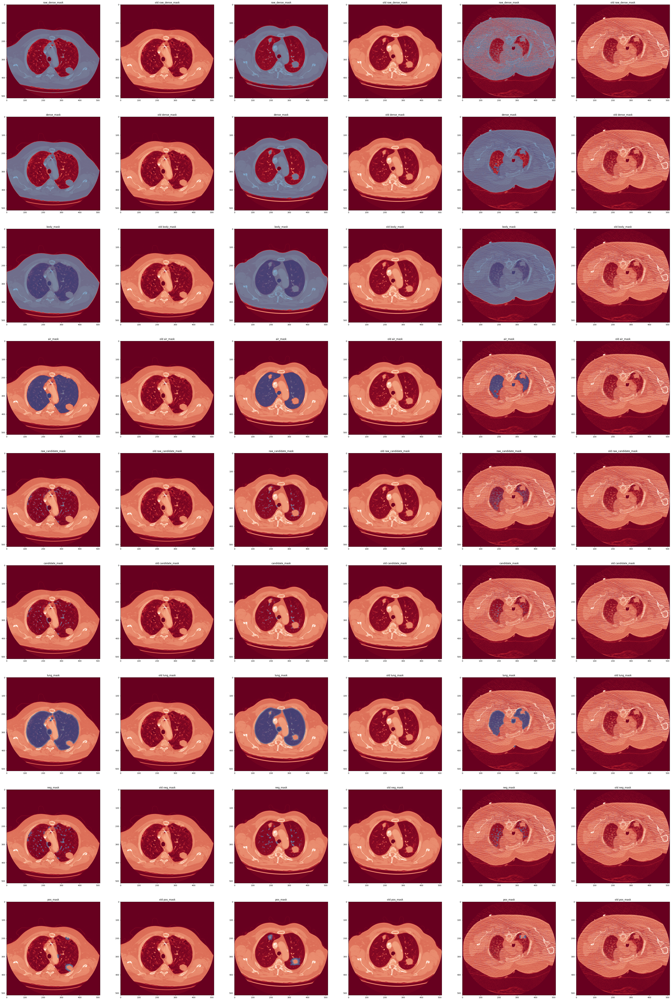

In [4]:
# --- Load candidate info and compute CTs and center slices ---
NUM_CASES = 3
start_index = 0
selected_cases = candidateInfo_list[start_index : start_index + NUM_CASES]

ct_infos = []
for case in selected_cases:
    ct = getCt(case.series_uid)
    center_irc = xyz2irc(case.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
    ct_infos.append((ct, center_irc))

# --- Set up plot ---
fig = plt.figure(figsize=(60, 90))
num_attrs = len(MaskTuple._fields)
num_cols = NUM_CASES * 2  # For new and old mask visualizations side by side

# --- Loop through CTs and display masks ---
for ct_idx, (ct, center_irc) in enumerate(ct_infos):
    slice_index = int(center_irc.index)
    # Get the mask from the segmentation model
    mask_tup = build2dLungMask(ct.series_uid, slice_index)

    for attr_idx, attr_name in enumerate(mask_tup._fields):
        # Compute subplot indices
        row = attr_idx
        col = ct_idx * 2

        # --- Plot new mask overlay ---
        subplot_index = row * num_cols + col + 1
        subplot = fig.add_subplot(num_attrs, num_cols, subplot_index)
        subplot.set_title(attr_name)

        base_slice = ct.hu_a[slice_index]
        mask_slice = mask_tup[attr_idx][0][0].cpu()

        subplot.imshow(base_slice, clim=(-1000, 3000), cmap='RdGy')
        subplot.imshow(mask_slice, clim=clim, cmap=tblue)

        # --- Plot old version (if needed) ---
        subplot_index_old = subplot_index + 1
        subplot_old = fig.add_subplot(num_attrs, num_cols, subplot_index_old)
        subplot_old.set_title('old ' + attr_name)

        subplot_old.imshow(base_slice, clim=(-1000, 3000), cmap='RdGy')


This cell is for manually inspecting whether the computed center of a lung nodule (from metadata) correctly aligns with what looks like a nodule in the actual CT image.

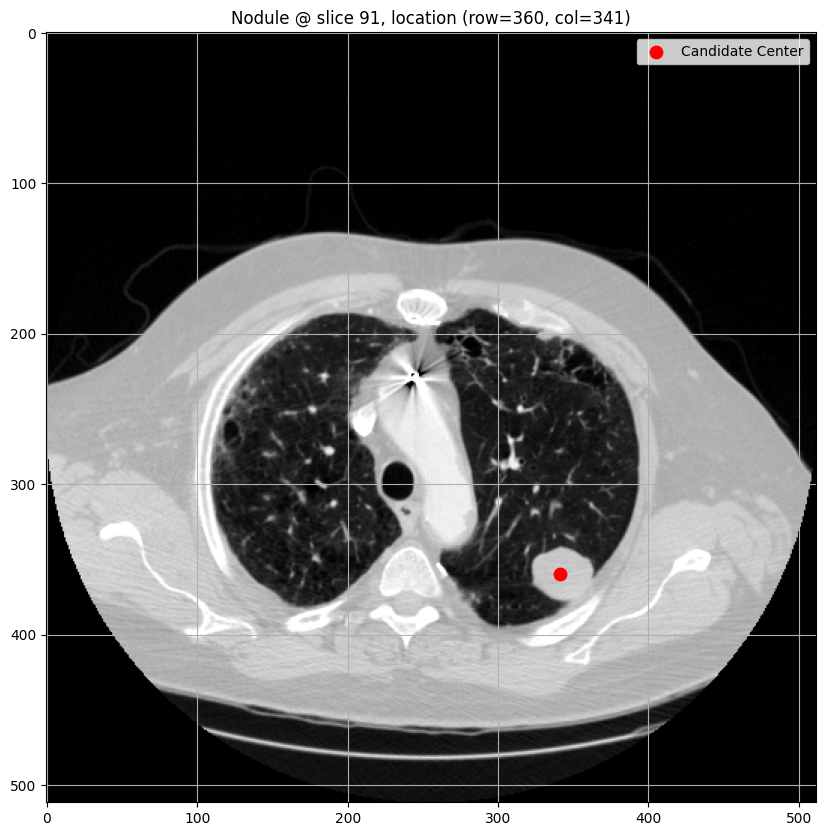

In [5]:
nit_ndx = 0
candidateInfo_tup = candidateInfo_list[nit_ndx]
ct = getCt(candidateInfo_tup.series_uid)
center_irc = xyz2irc(candidateInfo_tup.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)

# Visual overlay on the CT slice to confirm correctness
plt.figure(figsize=(10, 10))
ct_slice = ct.hu_a[int(center_irc.index)]
plt.imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
"""
imshow() uses (x, y) = (column, row) — i.e., image coordinates with:
x-axis: horizontal, left to right → column
y-axis: vertical, top to bottom → row
"""
plt.scatter(center_irc.col, center_irc.row, color='red', s=80, label='Candidate Center')
plt.title(f'Nodule @ slice {int(center_irc.index)}, location (row={int(center_irc.row)}, col={int(center_irc.col)})')
plt.legend()
plt.grid(True)
plt.show()


2025-05-26 11:55:52,300 INFO     pid:30728 p2ch13.vis:186:forward ['gcc_g', tensor(0., device='cuda:0'), tensor(0.4019, device='cuda:0'), tensor(2., device='cuda:0')]


0.00510406494140625


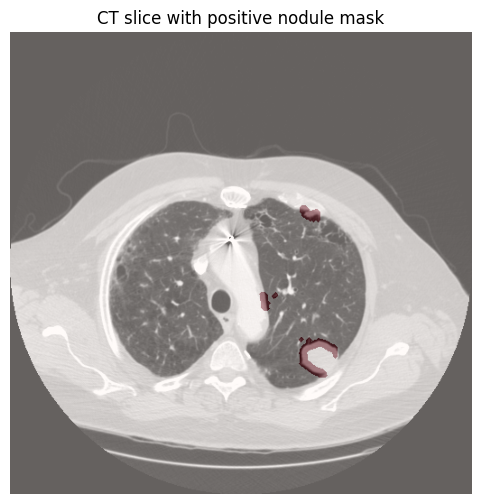

In [6]:
# Build masks from a CT slice
mask_tup = build2dLungMask(ct.series_uid, int(center_irc.index))
"""
The shape of NumPy array x is [1,1,512,512].
[0][0] removes the first 2 dimensions of x: batch and channel. The final shape is [512, 512] which represents the actual binary mask.
Take each field in mask_tup, convert it from GPU tensor → 2D NumPy mask → rebuild the same MaskTuple structure with these new values.
"""
mask_tup = mask_tup._make(x.cpu().numpy()[0][0] for x in mask_tup)

# Computes the fraction of the image area that is labeled as a positive nodule.
print(mask_tup.pos_mask.sum() / (512*512))

plt.figure(figsize=(6, 6))
plt.imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)  # CT image in Hounsfield units
plt.imshow(mask_tup.pos_mask, cmap='Reds', alpha=0.4)     # Overlay nodule mask in red
plt.title("CT slice with positive nodule mask")
plt.axis('off')
plt.show()

It’s a binary mask (values 0 or 1) that represents the entire physical body inside the CT image — i.e., everything that is not air. It excludes air both outside and inside, focusing on soft tissue and structures.

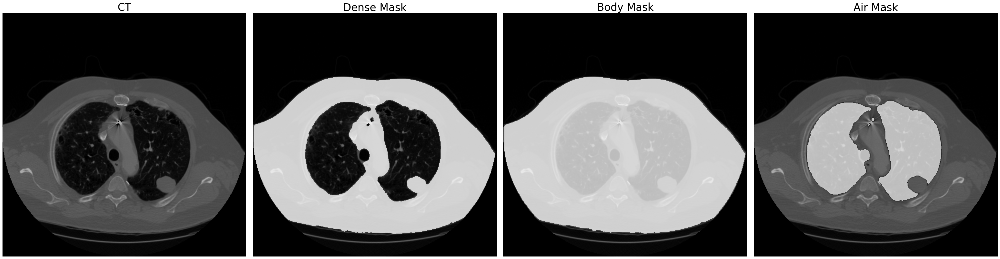

In [7]:
fig, axes = plt.subplots(1, 4, figsize=(40, 10))

titles = ['CT', 'Dense Mask', 'Body Mask', 'Air Mask']
masks = [None, mask_tup.dense_mask, mask_tup.body_mask, mask_tup.air_mask]

for ax, title, mask in zip(axes, titles, masks):
    ax.set_title(title, fontsize=30)
    ax.tick_params(labelsize=20)
    ax.imshow(ct_slice, cmap='gray', vmin=-1000, vmax=2000)
    if mask is not None:
        ax.imshow(mask, cmap=tgray, vmin=0, vmax=1)
    ax.axis('off')

plt.tight_layout()
plt.show()

Only `pos_mask` is directly derived from the ground-truth annotations.

**`neg_mask` is *not* directly derived from ground-truth annotations.**

`neg_mask` is computed from **raw CT image data** using:

* Intensity thresholding,
* Morphological operations,
* Lung region constraints,

but **not** from labeled nodules.

It **does** reference ground truth **indirectly** — by **excluding** real nodules:

```python
neg_mask &= ~pos_mask  # Remove ground-truth positive regions
```

So:

* `pos_mask` **is** from labels (i.e., ground truth).
* `neg_mask` is **CT-derived**, but avoids overlap with labels to ensure it's truly negative.
* `neg_mask` contains **"hard negatives"**: they look like nodules but aren’t labeled as such.
* These help the model learn what **not** to classify as positive.

A voxel is marked as nodule-like (i.e. part of candidate_mask) if:

- HU > –600 → it's dense like soft tissue;

- Inside the lungs (air_mask);

- Has nodule-like shape after morphology.

`neg_mask` is made from these "nodule-like" regions that are not labeled as actual nodules.

`candidate_mask` consists of `pos_mask` and `neg_mask`.

---

## 🎯 Summary Table

| Mask                      | Determined By                               | Based on Ground Truth?                      | Meaning                                                      |
| ------------------------- | ------------------------------------------- | ------------------------------------------- | ------------------------------------------------------------ |
| `candidate_mask`          | CT scan intensity + morphology              | ❌ No                                        | Dense regions that might be nodules                          |
| `neg_mask` (aka ben mask) | `candidate_mask` – `pos_mask` (and in lung) | ⚠️ Indirectly (filtered using ground truth) | Looks like a nodule but is not labeled (likely benign or FP) |
| `pos_mask` (aka mal mask) | Ground-truth annotation mask                | ✅ Yes                                       | True labeled nodules (malignant)                             |

---

## 🔬 Detailed Breakdown

---

### 1. `candidate_mask`

#### ✅ Determined by:

* **Density** (`HU > -600`)
* **Location** (must be inside lungs)
* **Shape** (filtered by erosion/deposition)

#### ❌ Not based on labels

This is a **raw guess** of where nodules *might* be based only on the image data.

---

### 2. `neg_mask` (what you call "ben mask")

#### ✅ Determined by:

* Starts from `candidate_mask`
* Excludes any overlap with `pos_mask`
* Keeps only regions inside the lung

#### ⚠️ Indirectly filtered by ground truth

This ensures it's "nodule-like but *not* a labeled nodule."

---

### 3. `pos_mask` (what you call "mal mask")

#### ✅ Determined by:

* Ground-truth annotation (`raw_pos_g`)
* Within lung
* Smoothed using morphological deposit

#### ✅ Fully based on ground truth

It **is** the labeled (malignant) nodule region.

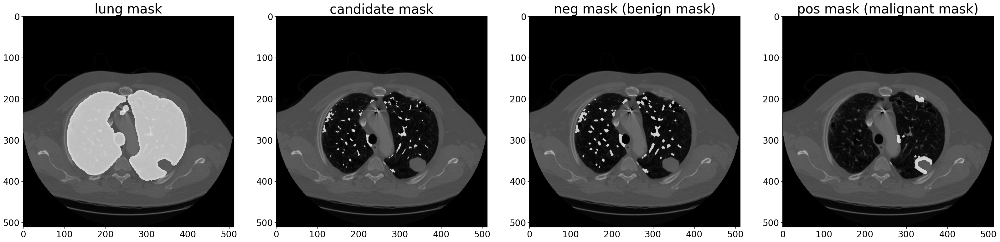

In [8]:
fig = plt.figure(figsize=(40, 10))

titles = ['lung mask', 'candidate mask', 'neg mask (benign mask)', 'pos mask (malignant mask)']
masks = [mask_tup.lung_mask, mask_tup.candidate_mask, mask_tup.neg_mask, mask_tup.pos_mask]

# Matplotlib’s subplot index starts at 1, not 0. So i must be 1, 2, 3, or 4.
for i, (title, mask) in enumerate(zip(titles, masks), start=1):
    subplot = fig.add_subplot(1, 4, i)
    subplot.set_title(title, fontsize=30)

    # Set tick label font sizes
    for label in subplot.get_xticklabels() + subplot.get_yticklabels():
        label.set_fontsize(20)

    # Overlay CT slice and mask
    subplot.imshow(ct_slice, clim=(-1000, 2000), cmap='gray')
    subplot.imshow(mask, clim=(0, 1), cmap=tgray)



```python
normalized_slice = ((ct_slice / 1000.0) + 1.0).clip(0, 1) / 2
```

### 1. `ct_slice / 1000.0`

* **`ct_slice`** is a 2D slice from a CT scan, containing pixel values in **Hounsfield Units (HU)**.

* HU values typically range from:

  * **Air** ≈ –1000
  * **Lung tissue** ≈ –700 to –300
  * **Water** = 0
  * **Bone** > +500

* Dividing by 1000 brings HU values into a rough scale of `[-1, +1]`:

  * Air ≈ –1.0
  * Water ≈ 0
  * Bone ≈ +1.0

---

### 2. `+ 1.0`

* This shifts the range from `[-1, +1]` → `[0, 2]`.

---

### 3. `.clip(0, 1)`

* Clamps the values:

  * Anything < 0 becomes 0
  * Anything > 1 becomes 1
* So now, the range is limited to `[0, 1]`.

This step is **crucial** for visualization to avoid extreme brightness/darkness.

---

### 4. `/ 2`

* Finally, the range becomes `[0, 0.5]`. Each pixel represents normalized Hounsfield Units (HU), where:

  * 0 = very dark (air)
  * 0.5 = medium brightness (soft tissue)

* This makes the base image **dimmer** so that **overlays like masks can be made visibly brighter by simple addition** (e.g., `+ 3 * normalized_slice * mask`).
* It leaves room in the \[0, 1] display range for brightening via masks without exceeding bounds.

---



The candidates.csv file contains information about all lumps that potentially look like nodules, whether those lumps are malignant, benign tumors, or something else altogether. We’ll use this as the basis for building a complete list of candidates that can then be split into our training and validation datasets. 

2025-05-26 11:56:07,681 INFO     pid:30728 p2ch13.vis:186:forward ['gcc_g', tensor(0., device='cuda:0'), tensor(0.4384, device='cuda:0'), tensor(2., device='cuda:0')]


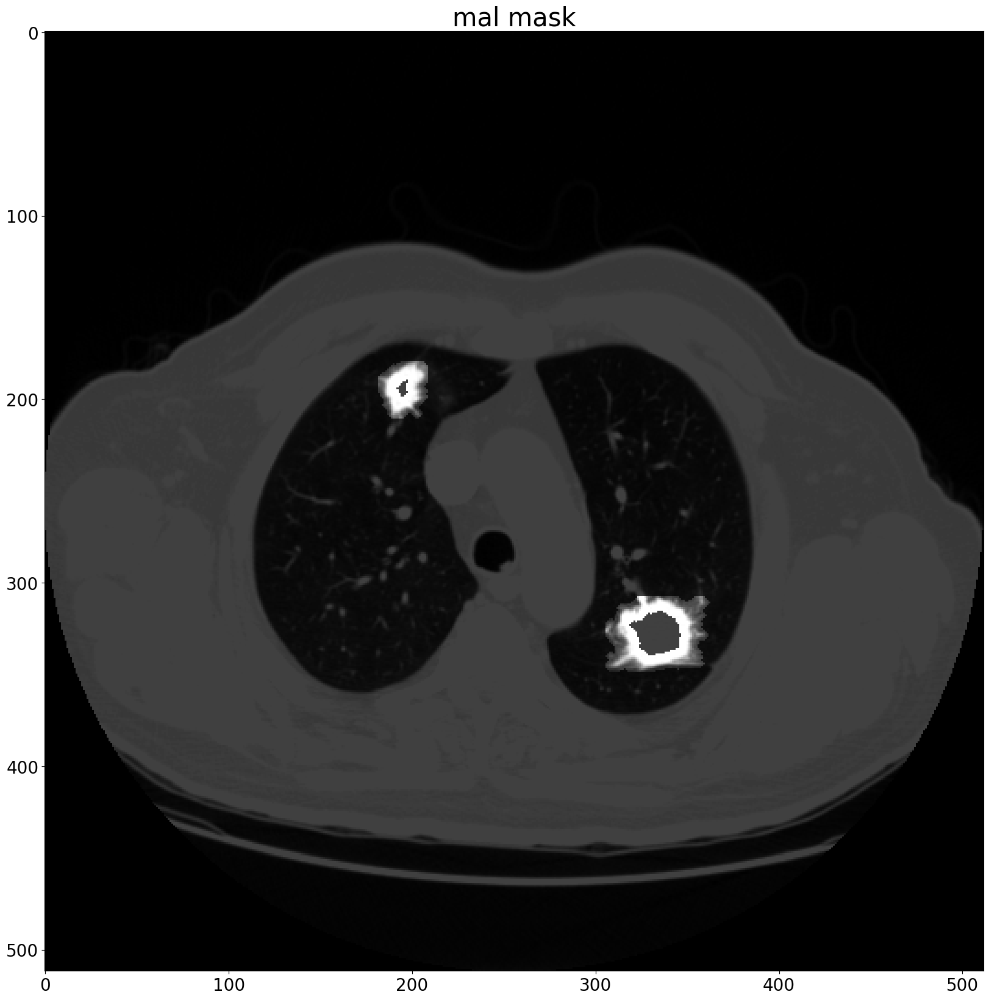

In [9]:
# Select the candidate
candidate_index = 1
candidate_info = candidateInfo_list[candidate_index]

# Load CT scan and convert world coordinates to voxel coordinates
ct = getCt(candidate_info.series_uid)
center_irc = xyz2irc(candidate_info.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)

# Generate 2D lung masks by the segmentation model and convert tensors to NumPy arrays

# raw_mask_tup is a MaskTuple with 9 tensor elements. Each tensor has shape [1, 1, 512, 512],
# representing a single-channel 2D mask with batch and channel dimensions.
raw_mask_tup = build2dLungMask(ct.series_uid, int(center_irc.index))
# [0, 0] removes the batch and channel dimension.
# The unpacking operator (*) passes the 9 [512, 512] NumPy arrays as separate arguments to MaskTuple(...), which expects 9 elements.
mask_tup = MaskTuple(*(tensor.cpu().numpy()[0, 0] for tensor in raw_mask_tup))

# Prepare the CT slice for visualization
ct_slice = ct.hu_a[int(center_irc.index)]
# Normalize CT scan HU values into the range [0, 0.5], making them visually suitable for display as a grayscale image
normalized_slice = ((ct_slice / 1000.0) + 1.0).clip(0, 1) / 2

# Plot the image with the positive mask overlay
fig = plt.figure(figsize=(20, 20))
subplot = fig.add_subplot(1, 1, 1)
subplot.set_title('mal mask', fontsize=30)
for label in subplot.get_xticklabels() + subplot.get_yticklabels():
    label.set_fontsize(20)

"""
Overlay mask: brighten the slice in areas where the mask is positive
If a pixel is part of the mask, its brightness is quadrupled.
Since normalized_slice is already ≤ 0.5, the result is ≤ 2.0.
But matplotlib's grayscale colormap (cmap='gray') will clip anything > 1 to pure white.
Quadrupling brightness in masked areas makes them stand out as bright white regions.
Non-nodule areas remain unchanged at normal brightness.
"""
plt.imshow(
    normalized_slice + 3 * normalized_slice * mask_tup.pos_mask,
    cmap='gray'
)


## 🔹1. What is `SegmentationTrainingApp`?

`SegmentationTrainingApp` is a **training controller class** for a segmentation model (like U-Net), defined in `training.py`. Its job is to:

* Parse training arguments (e.g., batch size, augmentation options, number of epochs).
* Set up training and validation datasets and data loaders.
* Apply augmentations if enabled.
* Train the model (forward pass, loss, backprop).
* Perform validation.
* Log metrics and images to TensorBoard.
* Save the trained model.

> ✅ It wraps the entire segmentation training workflow into one reusable class.

---

## 🔹2. What does `cls_app` represent?

```python
cls_app = SegmentationTrainingApp(['--augmented'])
```

This line:

* Creates an **instance** of the `SegmentationTrainingApp` class.
* Passes `['--augmented']` as command-line arguments, which enables **data augmentation**.

> ✅ `cls_app` is your main application object for running and controlling segmentation training logic.

---

## 🔹3. What is `train_dl`?

```python
train_dl = cls_app.initTrainDl()
```

This initializes the **training data loader**:

* It loads the **training dataset** using `TrainingLuna2dSegmentationDataset`.
* Wraps it in a PyTorch `DataLoader` that:

  * Batches samples
  * Loads them in parallel with `num_workers`
  * Transfers them to GPU if needed (`pin_memory=True`)

So `train_dl` is a **PyTorch `DataLoader` object** that iterates over batches of:

```python
ct_t, pos_t, series_uid, slice_ndx
```

Where:

* `ct_t`: input tensor of shape `[7, 64, 64]` (7 slices around the nodule)
* `pos_t`: ground truth segmentation mask
* `series_uid`: string ID of the CT scan
* `slice_ndx`: index of the CT slice

---

## 🔹4. What does `cls_app.initTrainDl()` do?

```python
train_dl = cls_app.initTrainDl()
```

### Full Process:

1. Internally calls `TrainingLuna2dSegmentationDataset(...)`:

   * Selects 2D image slices around annotated nodules.
   * Applies random crops (`64x64`) with some context.
   * Returns input–label pairs for training.

2. Wraps that dataset in a `DataLoader` with:

   * Batch size (default `16`, multiplied by GPU count if CUDA is used).
   * Background loading (`num_workers=8`)
   * Pinned memory for GPU acceleration.

> ✅ This function returns the training data loader that yields batches of augmented lung CT patches and labels.

---

## 🔹5. What is `train_dl.dataset[0]`?

```python
_ = train_dl.dataset[0]
```

This accesses the **first training sample** directly (without batching). It internally calls:

```python
TrainingLuna2dSegmentationDataset.__getitem__(0)
```

Which:

* Randomly picks a positive candidate (from `pos_list`)
* Crops a `[7, 96, 96]` volume around its center
* Randomly selects a `[64x64]` crop for training
* Returns:

```python
ct_t, pos_t, series_uid, slice_ndx
```

This is useful to inspect raw data and verify training inputs.

---

## Final Summary

| Code Line                                  | What It Does                                  | Output         |
| ------------------------------------------ | --------------------------------------------- | -------------- |
| `SegmentationTrainingApp(['--augmented'])` | Creates training controller with augmentation | `cls_app`      |
| `cls_app.initTrainDl()`                    | Initializes the training DataLoader           | `train_dl`     |
| `train_dl.dataset[idx]`                    | Gets a training sample (CT crop + mask)       | 4-tuple sample |

---


In [10]:
from p2ch13.training import SegmentationTrainingApp

cls_app = SegmentationTrainingApp(['--augmented'])
train_dl = cls_app.initTrainDl()

2025-05-26 11:56:13,907 INFO     pid:30728 p2ch13.model:078:__init__ Segmentation Augmentation Configuration:
2025-05-26 11:56:13,908 INFO     pid:30728 p2ch13.model:079:__init__   flip:   True
2025-05-26 11:56:13,909 INFO     pid:30728 p2ch13.model:080:__init__   offset: 0.03
2025-05-26 11:56:13,909 INFO     pid:30728 p2ch13.model:081:__init__   scale:  0.2
2025-05-26 11:56:13,909 INFO     pid:30728 p2ch13.model:082:__init__   rotate: True
2025-05-26 11:56:13,910 INFO     pid:30728 p2ch13.model:083:__init__   noise:  25.0
2025-05-26 11:56:13,910 INFO     pid:30728 p2ch13.training:188:initModel Using CUDA; 1 devices.


In the LUNA16 dataset, each nodule is labeled with its center position and diameter, but not with a full segmentation mask across all slices. This means we don’t have detailed labels for every CT slice. To train the model, we generate an approximate 3D mask around the nodule center using the provided diameter and a Hounsfield Unit threshold to estimate where the nodule is. However, during training, we only use the center slice of this mask as the label. The slices before and after are included as input to provide context, but they are not used for supervision. This approach allows the model to learn from 3D information, even though the label is only available for one slice.

Supervision refers to the use of ground-truth labels to guide the model’s learning. Supervision is done by providing a labeled segmentation mask that the model tries to predict and compare against during training.

Each CandidateInfoTuple refers to a 3D coordinate in the full CT volume (via center_xyz).
- Later in training:
- A 3D chunk is extracted around that point: (depth=7, height=96, width=96)
- The model only trains on the center slice from that chunk
  - Context slices are only used as additional input channels to help the model make a better prediction for the center slice.

The model’s input is a 3D volume:
→ Shape [7, 64, 64] → 3 context slices before + 1 center slice + 3 context slices after

The model’s output is a 2D segmentation mask:
→ Shape [1, 64, 64] → Only the center slice is labeled and supervised

### Why not train on all 7 slices?

- Only the center slice is accurately labeled (from annotation data).

- Neighboring slices might contain partial structures, but we don’t have ground truth masks for them.

- Training only on the center avoids label noise and keeps the model focused.


Sample Summary:
  Patch Index            : 40
  CT Series UID          : 1.3.6.1.4.1.14519.5.2.1.6279.6001.271307051432838466826189754230
  Mask Shape             : torch.Size([1, 64, 64])  # (channels=1, height=64, width=64)
  Center Slice Index     : 41       # Slice index in original CT volume



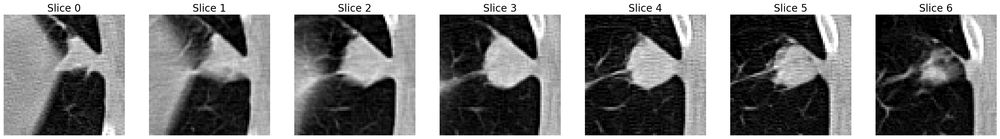

In [11]:
import matplotlib.pyplot as plt

# Index into the training dataset: selects the N-th training patch (not the CT slice index!)
patch_index = 40

# Load one training sample: a 3D CT patch, its segmentation mask, the scan ID, and the central slice index in the original CT
ct_patch_3d, center_slice_mask, series_uid, center_slice_index = train_dl.dataset[patch_index]

# The patch contains 7 slices/channels: 3 before, 1 center, 3 after
# Number of channels = number of slices
num_context_slices = ct_patch_3d.shape[0]

# Create a wide figure: 5 inches per slice, fixed 5-inch height
# figsize is assigned a tuple of (width_in_inches, height_in_inches).
fig = plt.figure(figsize=(num_context_slices * 5, 5))

# Plot all slices in the patch (usually 7)
for slice_offset in range(num_context_slices):
  ax = fig.add_subplot(1, num_context_slices, slice_offset + 1)
  ax.set_title(f'Slice {slice_offset}', fontsize=20)
  ax.imshow(ct_patch_3d[slice_offset].numpy(), cmap='gray', clim=(-1000, 500))
  ax.axis('off')

# Print sample-level debug info
print(f"""
Sample Summary:
  Patch Index            : {patch_index}
  CT Series UID          : {series_uid}
  Mask Shape             : {center_slice_mask.shape}  # (channels=1, height=64, width=64)
  Center Slice Index     : {center_slice_index}       # Slice index in original CT volume
""")

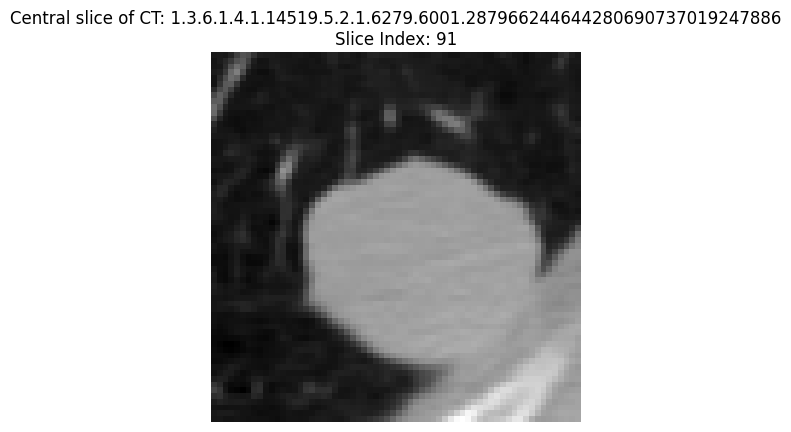

In [13]:
from p2ch13.dsets import LunaPatchSegDataset
import matplotlib.pyplot as plt

# Create a training dataset that returns 7-slice input patches centered on nodules
dataset = LunaPatchSegDataset(contextSlices_count=3)

# Get the first training sample
# This includes: the input patch, label mask, CT scan ID, and the slice index
input_patch_tensor, label_mask_tensor, ct_series_uid, center_slice_index = dataset[0]

# Display the central slice (index 3 out of 7) of the input patch
plt.imshow(input_patch_tensor[3], cmap='gray')
plt.title(f"Central slice of CT: {ct_series_uid}\nSlice Index: {center_slice_index}")
plt.axis('off')
plt.show()